# Analyze Simulation Output

If you run the Simulation with Rider the output is stored in `bin/Debug/net6.0/`. You can change the root path in with the `PATH` variable in the cell below if your output path is different.

In [ ]:
!pip install geopandas

In [21]:
from pathlib import Path

import matplotlib.pyplot as plt
import pandas as pd
import geopandas

In [24]:
# path from notebook directory to output of model
PATH = Path('./GeodataBlueprint/bin/Debug/net6.0/')

In [4]:
df = pd.read_csv(PATH / 'Human.csv', sep=';', parse_dates=['DateTime'])

In [5]:
df.head()

,Tick,Step,DateTime,IsCollidingEntity,LaneOnCurrentEdge,Length,ModalityType,PositionOnCurrentEdge,RouteIndex,TargetPoiCategory,TargetPoiName,X,Y,ID
0,0,0,2022-09-12,False,0,0,CarDriving,0.0,1,restaurant,Canton Restaurant,25.625533,-33.962125,8e69198b-ceae-40c2-a04a-454069541460
1,0,0,2022-09-12,False,0,0,CarDriving,0.0,1,restaurant,Ocean's 11 Seafood Bistro,25.542614,-33.980085,c28582a7-799b-48e9-bbc0-902baab4c661
2,0,0,2022-09-12,False,0,0,CarDriving,0.0,1,restaurant,Bella Napoli Restaurant,25.597867,-33.945901,ddedf34d-8882-4a0b-ac68-b09614266807
3,0,0,2022-09-12,False,0,0,CarDriving,0.0,1,restaurant,The Beach Hotel,25.664905,-33.994656,5e692664-c4a8-47cc-9106-934328bcc92a
4,0,0,2022-09-12,False,0,0,CarDriving,0.0,1,restaurant,Ziggy's,25.517917,-33.947544,4535d5b5-917e-4b21-87d5-dfcb21099ccd


In [6]:
unique_agents = list(df['ID'].unique())

In [7]:
len(unique_agents) # how many agents moved around?

10

## Identify how many destinations each agent drove to

In [8]:
agent_stats = []
for agent_id in unique_agents:
    # filter down CSV to only entries specific to ONE agent
    agent_df = df[df['ID'] == agent_id]
    
    agent_stats.append({
        'id': agent_id,
        'unqiue_routes': agent_df['RouteIndex'].max()
    })
stats_df = pd.DataFrame(agent_stats)

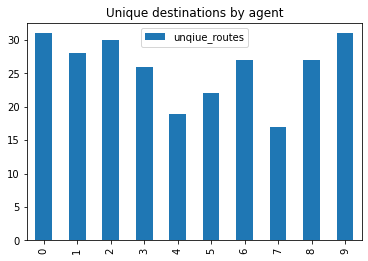

In [9]:
stats_df.plot.bar()
plt.title("Unique destinations by agent")
plt.show()

## "Heatmap" of routes of all agents

In [10]:
trips_gdf = geopandas.read_file(PATH / 'Human_trips.geojson')

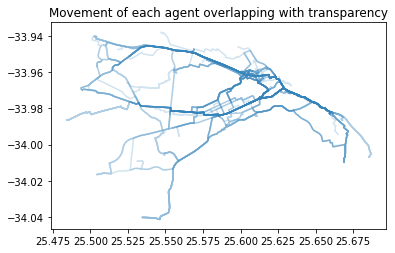

In [11]:
trips_gdf.plot(alpha=0.2)
plt.title("Movement of each agent overlapping with transparency")
plt.show()

## Interactive map of movement of all agents

This is done with [kepler.gl](https://kepler.gl/), for more flexibillity in configuration you can create maps on the site directly as well.


**ATTENTION**: To HAW ICC JupyterHub users, the interactive preview of the map *does not* work inside the HAW JupyterHub instance. you can rund the code thpugh and look at the saved `kepler_map.html` in your browser of choice. 

But it might be more straight forward to use Kepler.gl directly with you data instead of copying the data between your computer and the JupyterHub.

In [ ]:
!pip install keplergl

In [22]:
import keplergl

In [12]:
# Loads trips with movement of agents
with open(PATH / 'Human_trips.geojson', 'r') as f:
    trips_geojson = f.read()

In [14]:
# Load POIs into datafram
pois_gdf = geopandas.read_file(PATH / 'Resources/pois.geojson')
with open(PATH / 'Resources/pois.geojson', 'r') as f:
    pois_geojson = f.read()

In [15]:
# Load Graph into dataframe
graph_gdf = geopandas.read_file(PATH / 'Resources/edges.geojson')
with open(PATH / 'Resources/edges.geojson', 'r') as f:
    graph_geojson = f.read()

In [16]:
# load the config
%run map_config.py

In [17]:
# show the map, to add data run the next cell 
map_1 = keplergl.KeplerGl(height=600, config=config)
map_1

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'zooclhi', 'type': …

In [18]:
# after running this cell, the map above will update with the data and a timeslider after a short moment.
map_1.add_data(graph_geojson, "Graph")
map_1.add_data(pois_geojson, "POIs")
map_1.add_data(trips_geojson, "Trips")

In [19]:
# IMPORTANT! Changes made inside the map widget will be lost, after restarting the Notebook.
# If you editied anythin run this cell to persist the configuration.
with open('map_config.py', 'w') as f:
    f.write('config = {}'.format(map_1.config))

In [20]:
# If you want to persist the interactive map in a single HTML file you can look without the notbeook
# or share, run the following code
map_1.save_to_html(file_name='kepler_map.html')

Map saved to kepler_map.html!
